<a href="https://colab.research.google.com/github/Midhilesh29/Monkai_notebooks/blob/master/cornernet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
! git clone https://github.com/Tessellate-Imaging/Monk_Object_Detection.git

Cloning into 'Monk_Object_Detection'...
remote: Enumerating objects: 111, done.
remote: Counting objects: 100% (111/111), done.
remote: Compressing objects: 100% (79/79), done.
remote: Total 3854 (delta 66), reused 60 (delta 32), pack-reused 3743
Receiving objects: 100% (3854/3854), 152.76 MiB | 13.91 MiB/s, done.
Resolving deltas: 100% (868/868), done.
Checking out files: 100% (4035/4035), done.


In [0]:
! cd Monk_Object_Detection/6_cornernet_lite/installation && chmod +x install_colab.sh && ./install_colab.sh

  Created wheel for dicttoxml: filename=dicttoxml-1.7.4-cp36-none-any.whl size=17452 sha256=25cef497936b9a253f76a2a2d26582a1b6aa7a0c372043ae2d459495f22edac3
  Stored in directory: /root/.cache/pip/wheels/62/4f/a3/afd4a68f5add45a668c14efa53b64d5cffb2be6bacf993c151
Successfully built dicttoxml
running install
running bdist_egg
running egg_info
creating cpools.egg-info
writing cpools.egg-info/PKG-INFO
writing dependency_links to cpools.egg-info/dependency_links.txt
writing top-level names to cpools.egg-info/top_level.txt
writing manifest file 'cpools.egg-info/SOURCES.txt'
/usr/local/lib/python3.6/dist-packages/torch/utils/cpp_extension.py:304: UserWarning: Attempted to use ninja as the BuildExtension backend but we could not find ninja.. Falling back to using the slow distutils backend.
  warnings.warn(msg.format('we could not find ninja.'))
writing manifest file 'cpools.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
running build_ext
bui

In [0]:
import os
import sys

In [0]:
sys.path

['',
 '/env/python',
 '/usr/lib/python36.zip',
 '/usr/lib/python3.6',
 '/usr/lib/python3.6/lib-dynload',
 '/root/.local/lib/python3.6/site-packages',
 '/root/.local/lib/python3.6/site-packages/cpools-0.0.0-py3.6-linux-x86_64.egg',
 '/usr/local/lib/python3.6/dist-packages',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.6/dist-packages/IPython/extensions',
 '/root/.ipython']

In [0]:
sys.path.append("Monk_Object_Detection/6_cornernet_lite/lib/")

In [0]:
from train_detector import Detector

In [0]:
gtf = Detector();

In [0]:
root_dir = "/content/drive/My Drive/Monkai";
set_dir = "imagesTrain";
coco_dir = "PRImA Layout Analysis Dataset"
img_dir="./"

In [0]:
gtf.Train_Dataset(root_dir, coco_dir, img_dir, set_dir, batch_size=4, use_gpu=True, num_workers=4)

In [0]:
gtf.Model(model_name="CornerNet_Saccade")

In [0]:
gtf.Hyper_Params(lr=0.00025, total_iterations=1000)

In [0]:
gtf.Setup();

loading annotations into memory...
Done (t=0.95s)
creating index...
index created!
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
loading annotations into memory...
Done (t=0.15s)
creating index...
index created!
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Loading Model - core.models.CornerNet_Saccade
Model Loaded


In [0]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [0]:
gtf.Train();

start_iter       = 0
distributed      = False
world_size       = 0
initialize       = False
batch_size       = 4
learning_rate    = 0.00025
max_iteration    = 1000
stepsize         = 800
snapshot         = 500
val_iter         = 500
display          = 100
decay_rate       = 10
Process 0: building model...
total parameters: 116859857
start prefetching data...
shuffling indices...
start prefetching data...
shuffling indices...
start prefetching data...
start prefetching data...
shuffling indices...
shuffling indices...
setting learning rate to: 0.00025
training start...

 10%|████                                     | 98/1000 [05:19<47:31,  3.16s/it]

Process 0: training loss at iteration 100: 8.294380187988281
 20%|███████▉                                | 198/1000 [10:34<42:17,  3.16s/it]

Process 0: training loss at iteration 200: 9.691774368286133
 30%|███████████▉                            | 298/1000 [15:48<37:36,  3.21s/it]

Process 0: training loss at iteration 300: 8.62890529632

In [0]:
import os
import sys
sys.path.append("../../6_cornernet_lite/lib/")

In [0]:
from infer_detector import Infer

In [0]:
gtf = Infer();

In [0]:
f = open("/content/drive/My Drive/Monkai/PRImA Layout Analysis Dataset/classes.txt", 'r');
class_list = f.readlines();
f.close();
for i in range(len(class_list)):
    class_list[i] = class_list[i][:-1]

In [0]:
class_list

['caption',
 'credit',
 'drop-capital',
 'floating',
 'footer',
 'header',
 'heading',
 'page-number',
 'paragraph']

In [0]:
gtf.Model(class_list, 
          base="CornerNet_Saccade", 
          model_path="./cache/nnet/CornerNet_Saccade/CornerNet_Saccade_final.pkl")

total parameters: 116859857
loading from ./cache/nnet/CornerNet_Saccade/CornerNet_Saccade_final.pkl


**Model's prediction after 500 iterations**

In [0]:
!cp "/content/drive/My Drive/Monkai/input.tif" "Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/"

In [0]:
boxes = gtf.Predict("Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/input.tif", vis_thresh=0.3, output_img="output.jpg")

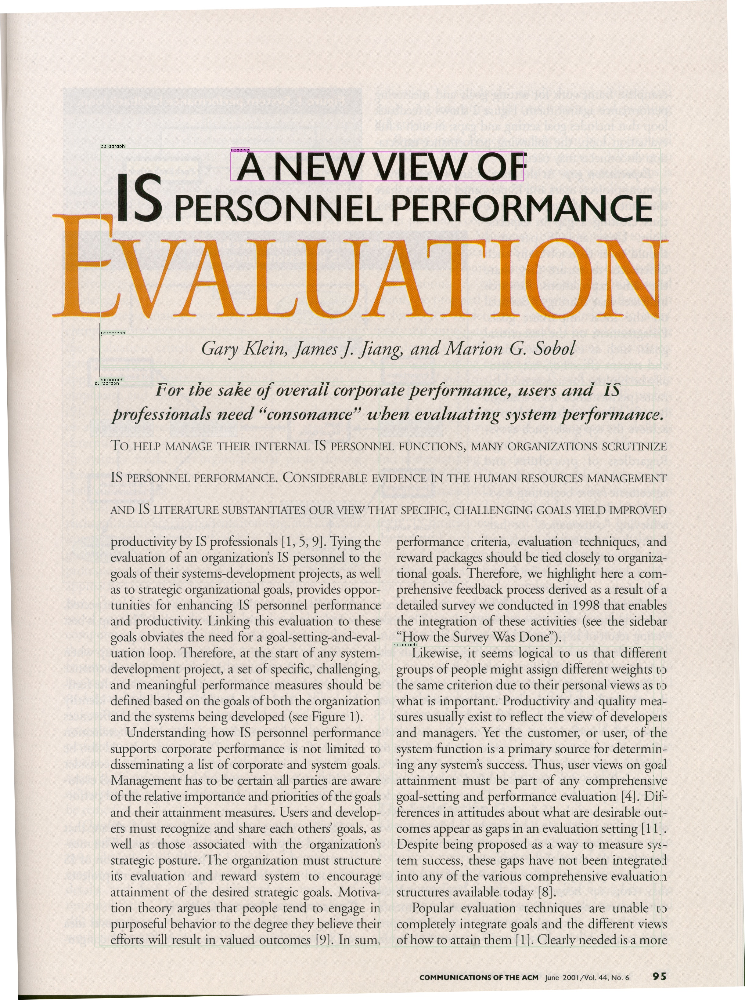

In [0]:
from IPython.display import Image
Image(filename='output.jpg')

In [0]:
!cp "/content/drive/My Drive/Monkai/input1.tif" "Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/"

In [0]:
boxes = gtf.Predict("Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/input1.tif", vis_thresh=0.3, output_img="output.jpg")

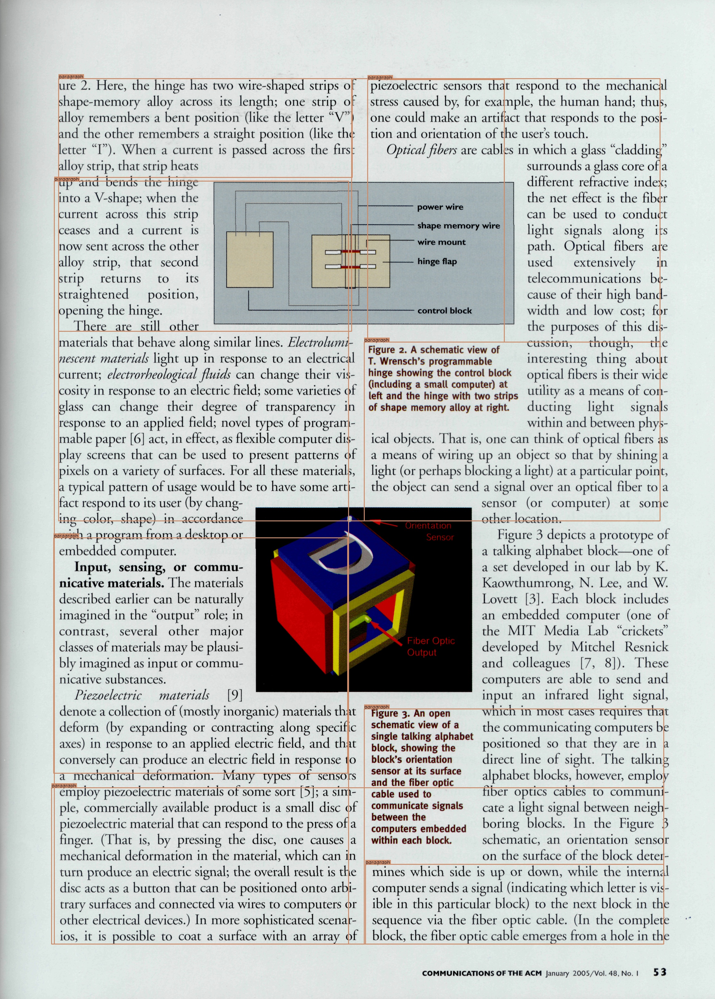

In [0]:
from IPython.display import Image
Image(filename='output.jpg')

In [0]:
!cp "/content/drive/My Drive/Monkai/input2.tif" "Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/"

In [0]:
boxes = gtf.Predict("Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/input2.tif", vis_thresh=0.3, output_img="output.jpg")

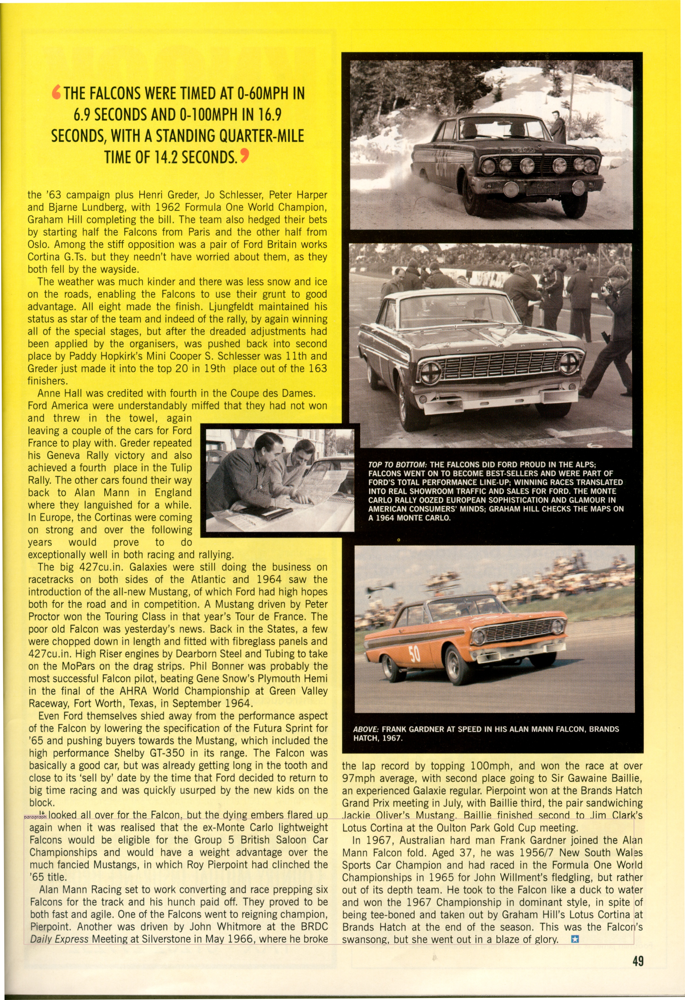

In [0]:
from IPython.display import Image
Image(filename='output.jpg')

**Model's prediction after 1000 iterations**

In [0]:
boxes = gtf.Predict("Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/input.tif", vis_thresh=0.3, output_img="output.jpg")

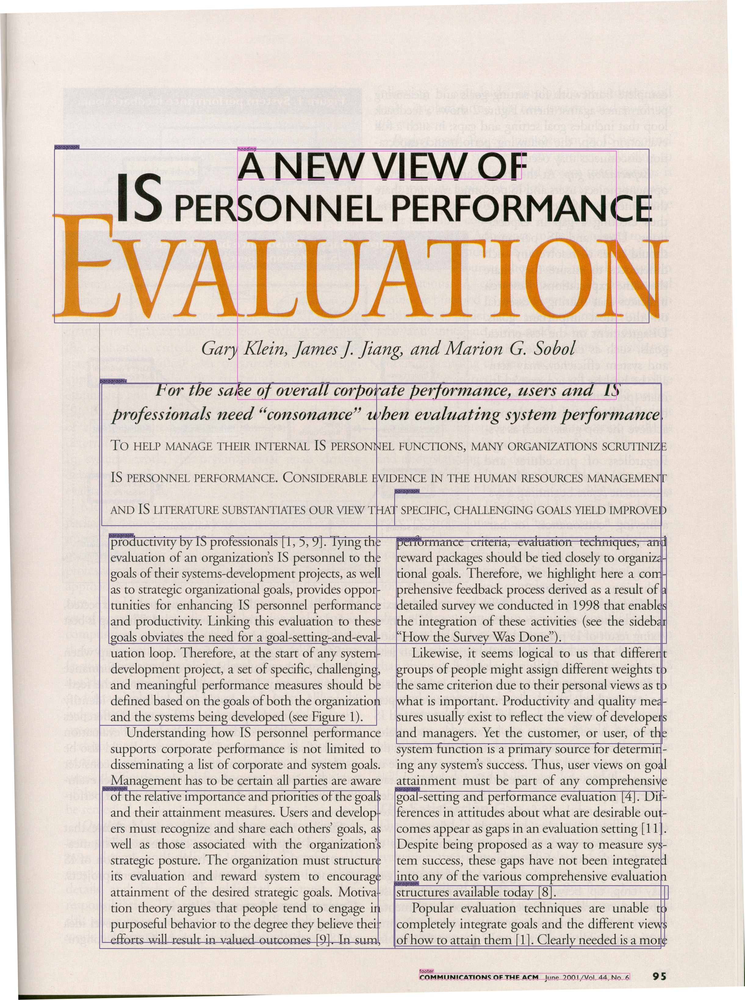

In [0]:
from IPython.display import Image
Image(filename='output.jpg')

In [0]:
boxes = gtf.Predict("Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/input1.tif", vis_thresh=0.3, output_img="output.jpg")

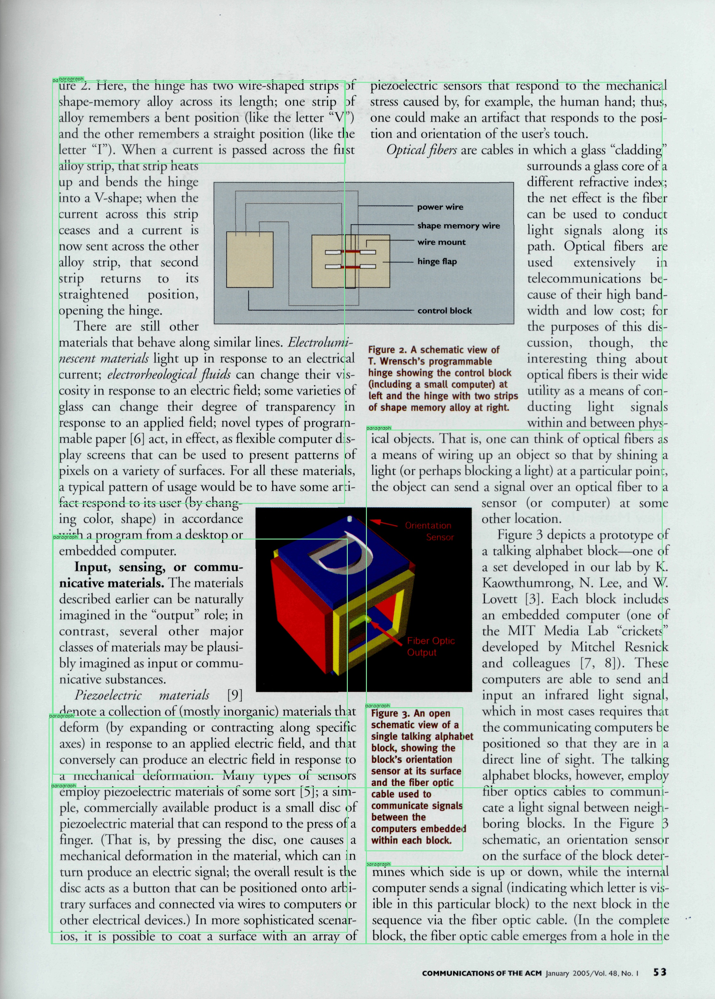

In [0]:
from IPython.display import Image
Image(filename='output.jpg')

In [0]:
boxes = gtf.Predict("Monk_Object_Detection/example_notebooks/sample_dataset/ship/test/input2.tif", vis_thresh=0.3, output_img="output.jpg")

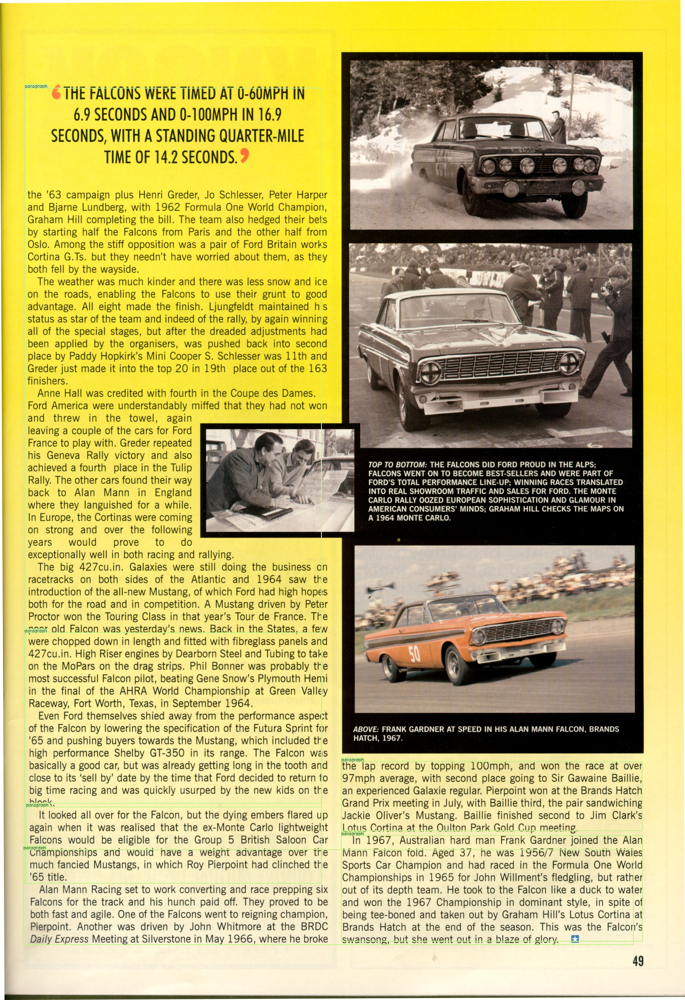

In [0]:
from IPython.display import Image
Image(filename='output.jpg')